In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns
import missingno as msn
import haversine as hs
from matplotlib.gridspec import GridSpec
from scipy.stats import chi2_contingency, f_oneway,jarque_bera,probplot
from sklearn.preprocessing import PowerTransformer
import warnings
warnings.filterwarnings("ignore")

In [2]:
def time_diff(row):

    order_picked = pd.to_timedelta(row['Time_Order_picked'])
    time_order =  pd.to_timedelta(row['Time_Orderd'])

    x = order_picked - time_order
    return x

def haversine_row(row):
    loc1 = (row['Restaurant_latitude'], row['Restaurant_longitude'])
    loc2 = (row['Delivery_location_latitude'], row['Delivery_location_longitude'])
    return hs.haversine(loc1, loc2, unit=hs.Unit.KILOMETERS)


def basic_data_cleaning(df):

    df.drop(columns=['ID'],inplace=True)
    df['Restaurant_latitude'] = abs(df['Restaurant_latitude'].replace(0,np.nan))
    df['Restaurant_longitude'] = abs(df['Restaurant_longitude'].replace(0,np.nan))
    cols = ["Delivery_location_latitude","Delivery_location_longitude"]
    df.loc[df['Restaurant_latitude'].isnull(), cols] = np.nan

    columns = ["Delivery_person_Age",  "Delivery_person_Ratings","Time_Orderd", "Weatherconditions", "Road_traffic_density",
    "multiple_deliveries", "Festival", "City"]
    for i in columns:
        df[i] = df[i].replace('NaN ',np.nan)
    df['Weatherconditions'] = df['Weatherconditions'].replace("conditions NaN",np.nan)
    df['Weatherconditions'] = df['Weatherconditions'].apply(lambda x: x.split()[-1] if isinstance(x, str) else x)
    df['Time_taken(min)'] = df['Time_taken(min)'].apply(lambda x: x[-2:]).astype("float")

    # changing datatype 
    df['Delivery_person_Age'] = df['Delivery_person_Age'].astype("float")
    df['Delivery_person_Ratings'] = df['Delivery_person_Ratings'].astype("float")
    df['Order_Date'] = pd.to_datetime(df['Order_Date'])
    df['multiple_deliveries'] = df['multiple_deliveries'].astype("float")

    # applying harversine distance
    df['Distance_res_to_loc_KM'] = df[['Restaurant_latitude', 'Restaurant_longitude','Delivery_location_latitude', 'Delivery_location_longitude']].apply(haversine_row,axis=1)
    df.insert(7,"Distance_res_loc_KM",df.pop('Distance_res_to_loc_KM'))

    # finding the time taken between restrurant & order pickup
    df["Time_res_pickup"] = (df[['Time_Order_picked','Time_Orderd']].apply(time_diff,axis=1).dt.total_seconds()/60).replace({-1425.:15., -1430.:10., -1435.:5.})
    df.insert(11,"Time_res_pickup",df.pop("Time_res_pickup"))
    df["order_time_hr"] = pd.to_datetime(df['Time_Orderd']).dt.hour
    df.insert(10,"order_time_hr",df.pop("order_time_hr"))
    df["time_of_day"] = pd.cut(
    df['order_time_hr'],
    bins=[0, 6, 12, 17, 20, 24],
    labels=['after midnight', 'morning', 'afternoon', 'evening', 'night'],
    right=False
    )
    df.insert(11,"time_of_day",df.pop("time_of_day"))

    # fixing values in columns:
    df['Road_traffic_density'] = df['Road_traffic_density'].str.strip().str.lower()
    df['Weatherconditions'] = df['Weatherconditions'].str.strip().str.lower()
    df['Type_of_order'] = df['Type_of_order'].str.strip().str.lower()
    df['Type_of_vehicle'] = df['Type_of_vehicle'].str.strip().str.lower()
    df['Festival'] = df['Festival'].str.strip().str.lower()
    df['City'] = df['City'].str.strip().str.lower()

    # dropping some rows
    df.drop(index=df[df['Delivery_person_Age'] <18].index,inplace=True)
    df.drop(index=df[df['Delivery_person_Ratings']>5].index,inplace=True)
    
    # creating rider city info
    rename_city = {"INDO":"Indore","BANG":"Bengaluru","COIMB":"Coimbatore","CHEN":"Chennai","HYD":"Hyderabad",
               "RANCHI":"Ranchi","MYS":"Mysore","DEH":"Dehradun","KOC":"Kochi","PUNE":"Pune","LUD":"Ludhiana",
               "LUDH":"Ludhiana","KNP":"Kanpur","MUM":"Mumbai","KOL":"Kolkata","JAP":"Jamshedpur","SUR":"Surat",
               "GOA":"Goa","AURG":"Aurangabad","AGR":"Agra","VAD":"Vadodara","ALH":"Allahabad","BHP":"Bhopal"}
    
    df['rider_city'] = df['Delivery_person_ID'].str.split("RES").str.get(0).replace(rename_city)
    df.insert(1,'rider_city',df.pop('rider_city'))
    df.insert(11,'order_dayname',df['Order_Date'].dt.day_name())
    df.insert(12,'order_in_weekend',np.where(df['order_dayname'].isin(['Saturday','Sunday']),1,0))
    

    df.drop(columns=['Delivery_person_ID'],inplace=True)
    
    return df

In [3]:
df = pd.read_csv(r"E:\DATA SCIENCE & AI\PROJECTS\Swiggy Delivery Dataset\train.csv")

In [4]:
df = basic_data_cleaning(df)

In [5]:
df

,rider_city,Delivery_person_Age,Delivery_person_Ratings,Restaurant_latitude,Restaurant_longitude,Delivery_location_latitude,Delivery_location_longitude,Distance_res_loc_KM,Order_Date,Time_Orderd,...,Time_res_pickup,Weatherconditions,Road_traffic_density,Vehicle_condition,Type_of_order,Type_of_vehicle,multiple_deliveries,Festival,City,Time_taken(min)
0,Indore,37.0,4.9,22.745049,75.892471,22.765049,75.912471,3.025153,2022-03-19,11:30:00,...,15.0,sunny,high,2,snack,motorcycle,0.0,no,urban,24.0
1,Bengaluru,34.0,4.5,12.913041,77.683237,13.043041,77.813237,20.183558,2022-03-25,19:45:00,...,5.0,stormy,jam,2,snack,scooter,1.0,no,metropolitian,33.0
2,Bengaluru,23.0,4.4,12.914264,77.678400,12.924264,77.688400,1.552760,2022-03-19,08:30:00,...,15.0,sandstorms,low,0,drinks,motorcycle,1.0,no,urban,26.0
3,Coimbatore,38.0,4.7,11.003669,76.976494,11.053669,77.026494,7.790412,2022-04-05,18:00:00,...,10.0,sunny,medium,0,buffet,motorcycle,1.0,no,metropolitian,21.0
4,Chennai,32.0,4.6,12.972793,80.249982,13.012793,80.289982,6.210147,2022-03-26,13:30:00,...,15.0,cloudy,high,1,snack,scooter,1.0,no,metropolitian,30.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45588,Jamshedpur,30.0,4.8,26.902328,75.794257,26.912328,75.804257,1.489848,2022-03-24,11:35:00,...,10.0,windy,high,1,meal,motorcycle,0.0,no,metropolitian,32.0
45589,Agra,21.0,4.6,NaN,NaN,NaN,NaN,NaN,2022-02-16,19:55:00,...,15.0,windy,jam,0,buffet,motorcycle,1.0,no,metropolitian,36.0
45590,Chennai,30.0,4.9,13.022394,80.242439,13.052394,80.272439,4.657202,2022-03-11,23:50:00,...,15.0,cloudy,low,1,drinks,scooter,0.0,no,metropolitian,16.0
45591,Coimbatore,20.0,4.7,11.001753,76.986241,11.041753,77.026241,6.232402,2022-03-07,13:35:00,...,5.0,cloudy,high,0,snack,motorcycle,1.0,no,metropolitian,26.0


In [17]:
# Segregation of columns:
num_cols = ["Delivery_person_Age","Delivery_person_Ratings","Distance_res_loc_KM","order_in_weekend","order_time_hr",
    "Time_res_pickup","Vehicle_condition","multiple_deliveries"]

cat_cols = ["rider_city","order_dayname","time_of_day","Weatherconditions","Road_traffic_density","Type_of_order",
    "Type_of_vehicle","Festival","City"]

loc_cols = ["Restaurant_latitude","Restaurant_longitude","Delivery_location_latitude","Delivery_location_longitude"]

time_cols = ["Order_Date","Time_Orderd","Time_Order_picked"]

In [18]:
len(num_cols)+len(cat_cols)+len(loc_cols)+len(time_cols)

24

### **Performing EDA:**

In [163]:
def numerical_analysis(df:pd.DataFrame,col,cat_col=None,bin="auto"):


    print(df[col].describe())
    fig = plt.figure(figsize=(11,8))
    grid = GridSpec(nrows=2,ncols=2,figure=fig)

    ax1 = fig.add_subplot(grid[0,0])
    ax2 = fig.add_subplot(grid[0,1])
    ax3 = fig.add_subplot(grid[1,0])


    sns.kdeplot(data=df, x=col,fill=True,ax=ax1,color='blue')
    ax1.set_title(f"KDE-plot of {col}",fontdict={"size":11,"fontweight":'bold'})
    sns.boxplot(data=df, x=col,hue=cat_col,fill=True,ax=ax2)
    ax2.set_title(f"Box-plot of {col}",fontdict={"size":11,"fontweight":'bold'})
    sns.histplot(data=df, x=col,fill=True,kde = True,ax=ax3,color='green',bins=bin)
    ax3.set_title(f"Hist-plot of {col}",fontdict={"size":11,"fontweight":'bold'})

    plt.suptitle(f"Numerical Analysis of {col}:",fontsize=14,fontweight='bold')
    plt.tight_layout(rect=[0,0,1,0.95])
    plt.show()

In [7]:
def numerical_categorical_analysis(df:pd.DataFrame,num_col,cat_col):
    fig,(ax1,ax2) = plt.subplots(2,2,figsize=(15,7.5))
    
    sns.barplot(data=df,x=cat_col,y=num_col,color='green',ax=ax1[0])
    ax1[0].set_title("Barplot bewteen these two columns",fontsize=12,fontweight='bold')

    sns.boxplot(data=df,x=num_col,y=cat_col,ax=ax1[1],hue=cat_col)
    ax1[1].set_title("Boxplot bewteen these two columns",fontsize=12,fontweight='bold')

    sns.violinplot(data=df,x=num_col,y=cat_col,ax=ax2[0],hue=cat_col)
    ax2[0].set_title("violinplot bewteen these two columns",fontsize=12,fontweight='bold')

    sns.stripplot(data=df,x=num_col,y=cat_col,ax=ax2[1],hue=cat_col)
    ax2[1].set_title("stripplot bewteen these two columns",fontsize=12,fontweight='bold')

    plt.suptitle(f"Numerical-Categorical Analysis between {num_col} & {cat_col}:",fontsize=14,fontweight='bold')

    plt.tight_layout(rect=[0,0,1,0.95])
    plt.show()

In [9]:
def categorical_analysis(df:pd.DataFrame,cat_col):
    display(pd.DataFrame({"Count":df[cat_col].value_counts(),
             "Percentage":round((df[cat_col].value_counts(normalize=True))*100,2).astype("str")+"%"}).reset_index())
    print("="*100)
    unique_list = df[cat_col].dropna().unique().tolist()
    print(f"For {cat_col}, these are the unique values:\n{unique_list}\nThere are total {df[cat_col].nunique()} unique values.")
    print("="*100)
    print("\n")
    fig = px.histogram(df,cat_col,text_auto=True,color_discrete_sequence=['#219ebc'])
    fig.show()

In [10]:
def multivariate_analysis(df:pd.DataFrame,num_col,cat_col1,cat_col2):
    fig,(ax1,ax2)=plt.subplots(2,2,figsize=(15,7.5))

    sns.barplot(data=df,x=cat_col1,y=num_col,hue=cat_col2,ax=ax1[0])
    ax1[0].set_title(f"Barplot between {cat_col1} & {num_col}",fontsize=12,fontweight='bold')

    sns.boxplot(data=df,x=cat_col1,y=num_col,hue=cat_col2,gap=0.1,ax=ax1[1])
    ax1[1].set_title(f"Boxplot between {cat_col1} & {num_col}",fontsize=12,fontweight='bold')

    sns.violinplot(data=df,x=cat_col1,y=num_col,hue=cat_col2,dodge=True,ax=ax2[0])
    ax2[0].set_title(f"violinplot between {cat_col1} & {num_col}",fontsize=12,fontweight='bold')

    sns.stripplot(data=df,x=cat_col1,y=num_col,hue=cat_col2,dodge=True,ax=ax2[1])
    ax2[1].set_title(f"violinplot between {cat_col1} & {num_col}",fontsize=12,fontweight='bold')

    plt.suptitle(f"Multivariate Analysis among {cat_col1},{cat_col2} and {num_col}:",fontsize=14,fontweight='bold')
    plt.show()

In [11]:
# test the relationship between two categorical features
def chi2_test(df:pd.DataFrame,col1,col2,alpha=0.05):
    print(f"Null Hypothesis: There is no relationship between {col1} & {col2}.")
    data = df.loc[:,[col1,col2]].dropna()
    contengency_tab = pd.crosstab(data[col1],data[col2])
    _,p_val,_,_=chi2_contingency(contengency_tab)
    print(p_val)
    if p_val<alpha:
        print(f"Reject the null hypothesis.\nThere is a strong relationship between {col1} & {col2}.")
    else:
        print(f"Fail to reject the null hypothesis.\nThere is a no relationship between {col1} & {col2}.")

In [12]:
def ANOVA(df:pd.DataFrame,num_col,cat_col,alpha=0.05):
    print(f"Null Hypothesis: There is no relationship between {num_col} & {cat_col}.")
    data = df.loc[:,[num_col,cat_col]].dropna()

    cat_group = data.groupby(cat_col)
    groups = [group[num_col].values for _,group in cat_group]
    f_stat,p_val =f_oneway(*groups)
    print(p_val)
    
    if p_val<alpha:
        print(f"Reject the null hypothesis.\nThere is a strong relationship between {num_col} & {cat_col}.")
    else:
        print(f"Fail to reject the null hypothesis.\nThere is a no relationship between {num_col} & {cat_col}.")

In [13]:
def test_for_normality(df,col,alpha=0.05):
    print(f"Null Hypothesis: {col} is normally distributed.")
    data = df[col]
    _,p_val = jarque_bera(data)
    print(p_val)
    if p_val<alpha:
        print(f"Reject the null hypothesis.\n{col} is not normally distriuted.")
    else:
        print(f"Fail to reject the null hypothesis.\n{col} is normally distriuted.")

____________________________

## **Performing EDA:**

### **Target column Analysis:**

#### **`Time_taken(min)`:**

count    45502.000000
mean        26.297591
std          9.386419
min         10.000000
25%         19.000000
50%         26.000000
75%         32.000000
max         54.000000
Name: Time_taken(min), dtype: float64


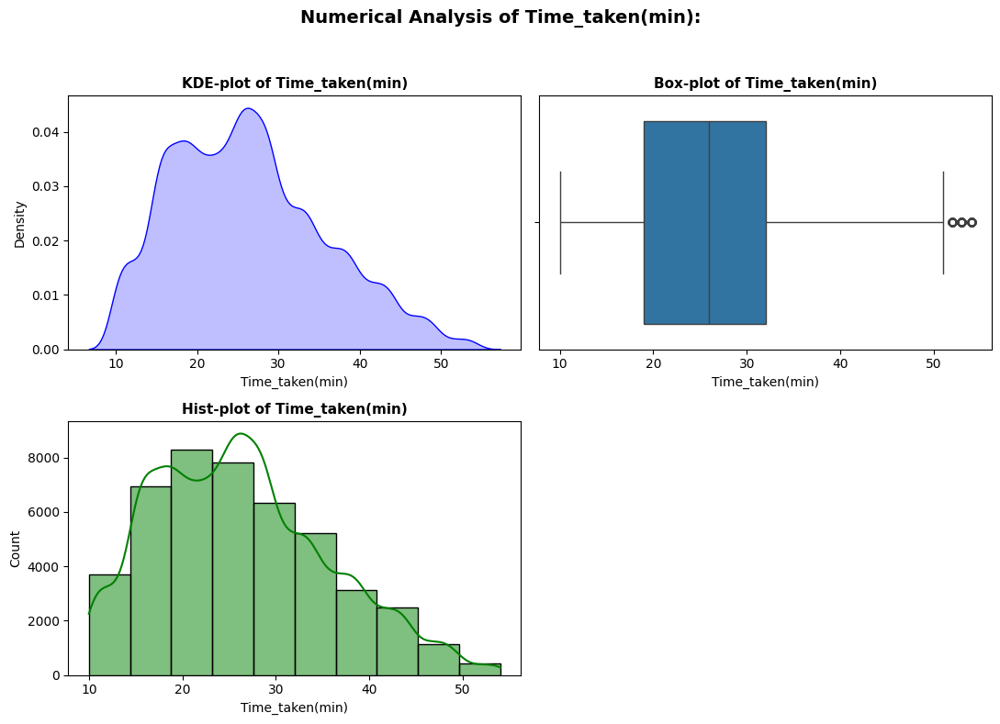

In [43]:
numerical_analysis(df,'Time_taken(min)',bin=10)

**Observation:**
- Our target column is not perfectly continuous.

- It has two peaks like bimodal.

- It has some extreme values which are not outliers.

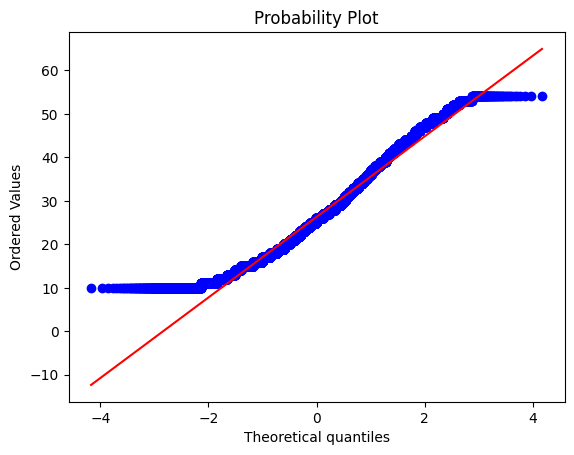

In [44]:
# Q-Q plot
probplot(df['Time_taken(min)'],plot=plt)
plt.show()

In [45]:
test_for_normality(df,'Time_taken(min)')

Null Hypothesis: Time_taken(min) is normally distributed.
0.0
Reject the null hypothesis.
Time_taken(min) is not normally distriuted.


In [46]:
# fixing the terget column with normal Distribution
from sklearn.preprocessing import PowerTransformer
pt = PowerTransformer()

df['time_taken'] = pt.fit_transform(df[['Time_taken(min)']])

In [47]:
df

,rider_city,Delivery_person_Age,Delivery_person_Ratings,Restaurant_latitude,Restaurant_longitude,Delivery_location_latitude,Delivery_location_longitude,Distance_res_loc_KM,Order_Date,Time_Orderd,...,Weatherconditions,Road_traffic_density,Vehicle_condition,Type_of_order,Type_of_vehicle,multiple_deliveries,Festival,City,Time_taken(min),time_taken
0,Indore,37.0,4.9,22.745049,75.892471,22.765049,75.912471,3.025153,2022-03-19,11:30:00,...,sunny,high,2,snack,motorcycle,0.0,no,urban,24.0,-0.130153
1,Bengaluru,34.0,4.5,12.913041,77.683237,13.043041,77.813237,20.183558,2022-03-25,19:45:00,...,stormy,jam,2,snack,scooter,1.0,no,metropolitian,33.0,0.775092
2,Bengaluru,23.0,4.4,12.914264,77.678400,12.924264,77.688400,1.552760,2022-03-19,08:30:00,...,sandstorms,low,0,drinks,motorcycle,1.0,no,urban,26.0,0.088493
3,Coimbatore,38.0,4.7,11.003669,76.976494,11.053669,77.026494,7.790412,2022-04-05,18:00:00,...,sunny,medium,0,buffet,motorcycle,1.0,no,metropolitian,21.0,-0.482135
4,Chennai,32.0,4.6,12.972793,80.249982,13.012793,80.289982,6.210147,2022-03-26,13:30:00,...,cloudy,high,1,snack,scooter,1.0,no,metropolitian,30.0,0.494134
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45588,Jamshedpur,30.0,4.8,26.902328,75.794257,26.912328,75.804257,1.489848,2022-03-24,11:35:00,...,windy,high,1,meal,motorcycle,0.0,no,metropolitian,32.0,0.683422
45589,Agra,21.0,4.6,NaN,NaN,NaN,NaN,NaN,2022-02-16,19:55:00,...,windy,jam,0,buffet,motorcycle,1.0,no,metropolitian,36.0,1.039335
45590,Chennai,30.0,4.9,13.022394,80.242439,13.052394,80.272439,4.657202,2022-03-11,23:50:00,...,cloudy,low,1,drinks,scooter,0.0,no,metropolitian,16.0,-1.151494
45591,Coimbatore,20.0,4.7,11.001753,76.986241,11.041753,77.026241,6.232402,2022-03-07,13:35:00,...,cloudy,high,0,snack,motorcycle,1.0,no,metropolitian,26.0,0.088493


count    4.550200e+04
mean     2.920124e-16
std      1.000011e+00
min     -2.168378e+00
25%     -7.357474e-01
50%      8.849282e-02
75%      6.834222e-01
max      2.373547e+00
Name: time_taken, dtype: float64


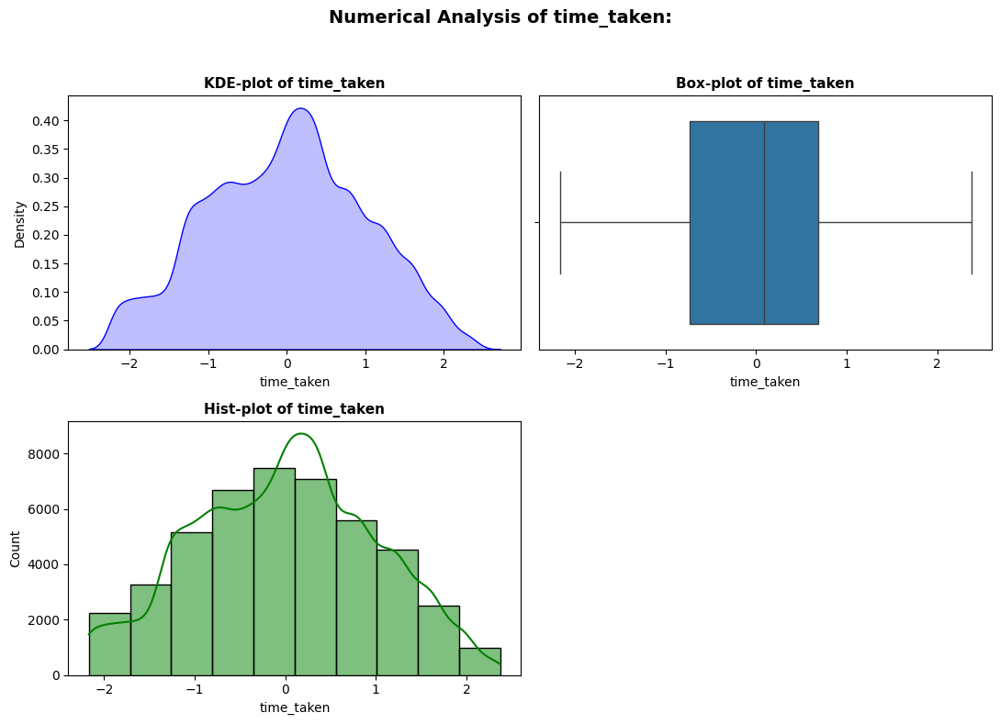

In [48]:
numerical_analysis(df,'time_taken',bin=10)

- we kind of fixed the target column.

____________________________

#### **Categorical Columns Analysis:**

In [25]:
cat_df = df[cat_cols]
cat_df.sample(5)

,rider_city,order_dayname,time_of_day,Weatherconditions,Road_traffic_density,Type_of_order,Type_of_vehicle,Festival,City
35177,Jamshedpur,Friday,afternoon,fog,medium,drinks,motorcycle,no,metropolitian
25351,Mumbai,Sunday,morning,windy,high,buffet,scooter,no,urban
85,Hyderabad,Wednesday,night,stormy,jam,buffet,motorcycle,no,metropolitian
2688,Surat,Wednesday,evening,cloudy,medium,meal,electric_scooter,no,metropolitian
18561,Vadodara,Thursday,night,fog,low,buffet,motorcycle,no,urban


In [27]:
cat_df.describe().T

,count,unique,top,freq
rider_city,45502,22,Jamshedpur,3439
order_dayname,45502,7,Wednesday,7077
time_of_day,43862,5,night,18312
Weatherconditions,44977,6,fog,7654
Road_traffic_density,44992,4,low,15477
Type_of_order,45502,4,snack,11512
Type_of_vehicle,45502,4,motorcycle,26427
Festival,45274,2,no,44380
City,44304,3,metropolitian,34029


From here we can observe that --

- In Jamshedpur, most of delivery happened
- In a week, wednesday got the most deliveries.
- Most of weather is foggy (reason is obvious, we have data for jan,feb, march first couple of days & in that time in India, Winter happen.)

#### **`rider_city`:**

In [22]:
df['rider_city']

0            Indore
1         Bengaluru
2         Bengaluru
3        Coimbatore
4           Chennai
            ...    
45588    Jamshedpur
45589          Agra
45590       Chennai
45591    Coimbatore
45592        Ranchi
Name: rider_city, Length: 45502, dtype: object

In [23]:
categorical_analysis(df,'rider_city')

,rider_city,Count,Percentage
0,Jamshedpur,3439,7.56%
1,Ranchi,3222,7.08%
2,Bengaluru,3184,7.0%
3,Surat,3182,6.99%
4,Hyderabad,3177,6.98%
5,Mumbai,3168,6.96%
6,Mysore,3164,6.95%
7,Coimbatore,3162,6.95%
8,Vadodara,3159,6.94%
9,Indore,3154,6.93%


For rider_city, these are the unique values:
['Indore', 'Bengaluru', 'Coimbatore', 'Chennai', 'Hyderabad', 'Ranchi', 'Mysore', 'Dehradun', 'Kochi', 'Pune', 'Ludhiana', 'Kanpur', 'Mumbai', 'Kolkata', 'Jamshedpur', 'Surat', 'Goa', 'Aurangabad', 'Agra', 'Vadodara', 'Allahabad', 'Bhopal']
There are total 22 unique values.




We can observe that this column is not uniformly distributed. Also some major city like delhi is missing from this data.

**checking if there is any relationship between this column & target column:**

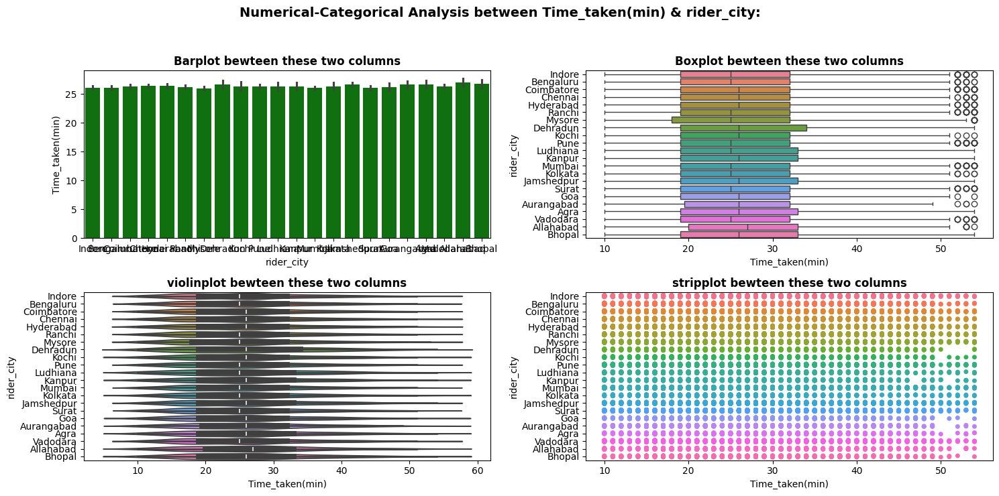

In [28]:
numerical_categorical_analysis(df,'Time_taken(min)','rider_city')

In [29]:
ANOVA(df,'Time_taken(min)','rider_city')

Null Hypothesis: There is no relationship between Time_taken(min) & rider_city.
0.1594719240748443
Fail to reject the null hypothesis.
There is a no relationship between Time_taken(min) & rider_city.


- **So, we can conclude that there is no  relationship.**

- Later on we may drop it.

________________________________

In [31]:
categorical_analysis(df,'order_dayname')

,order_dayname,Count,Percentage
0,Wednesday,7077,15.55%
1,Friday,7020,15.43%
2,Tuesday,6363,13.98%
3,Thursday,6338,13.93%
4,Saturday,6276,13.79%
5,Sunday,6231,13.69%
6,Monday,6197,13.62%


For order_dayname, these are the unique values:
['Saturday', 'Friday', 'Tuesday', 'Monday', 'Sunday', 'Wednesday', 'Thursday']
There are total 7 unique values.




Almost equally distributed.

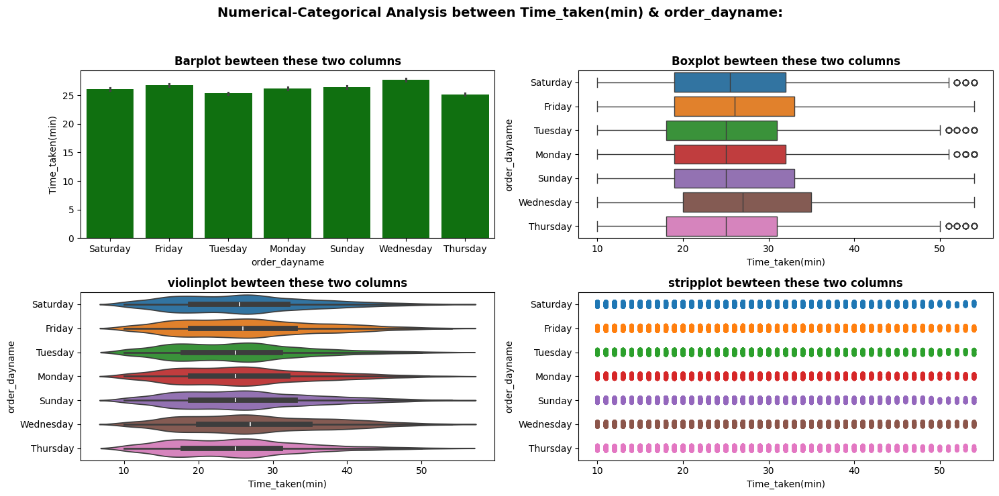

In [34]:
numerical_categorical_analysis(df,'Time_taken(min)','order_dayname')

In [51]:
ANOVA(df,'Time_taken(min)','order_dayname')

Null Hypothesis: There is no relationship between Time_taken(min) & order_dayname.
8.903928713022988e-74
Reject the null hypothesis.
There is a strong relationship between Time_taken(min) & order_dayname.


In [52]:
ANOVA(df,'time_taken','order_dayname')

Null Hypothesis: There is no relationship between time_taken & order_dayname.
2.882673051734773e-70
Reject the null hypothesis.
There is a strong relationship between time_taken & order_dayname.


We are seeing different p-values because the ANOVA test is sensitive to the scale and distribution of the numeric variable.

______________________________________

#### **`time_of_day`:**

In [35]:
categorical_analysis(df,'time_of_day')

,time_of_day,Count,Percentage
0,night,18312,41.75%
1,evening,13353,30.44%
2,morning,7718,17.6%
3,afternoon,4049,9.23%
4,after midnight,430,0.98%


For time_of_day, these are the unique values:
['morning', 'evening', 'afternoon', 'night', 'after midnight']
There are total 5 unique values.




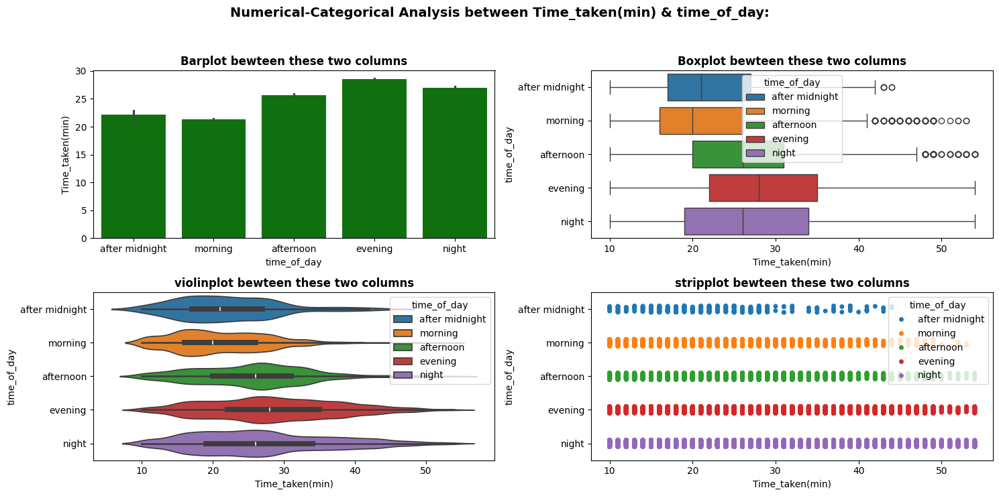

In [38]:
numerical_categorical_analysis(df,'Time_taken(min)','time_of_day')

In [40]:
px.strip(df,x='Time_taken(min)',y='time_of_day',color='time_of_day')

In [37]:
ANOVA(df,'Time_taken(min)','time_of_day')

Null Hypothesis: There is no relationship between Time_taken(min) & time_of_day.
0.0
Reject the null hypothesis.
There is a strong relationship between Time_taken(min) & time_of_day.


In [49]:
ANOVA(df,'time_taken','time_of_day')

Null Hypothesis: There is no relationship between time_taken & time_of_day.
0.0
Reject the null hypothesis.
There is a strong relationship between time_taken & time_of_day.


__________________________________________________

#### **`Weatherconditions`:**

In [54]:
categorical_analysis(df,'Weatherconditions')

,Weatherconditions,Count,Percentage
0,fog,7654,17.02%
1,stormy,7586,16.87%
2,cloudy,7536,16.76%
3,sandstorms,7495,16.66%
4,windy,7422,16.5%
5,sunny,7284,16.19%


For Weatherconditions, these are the unique values:
['sunny', 'stormy', 'sandstorms', 'cloudy', 'fog', 'windy']
There are total 6 unique values.




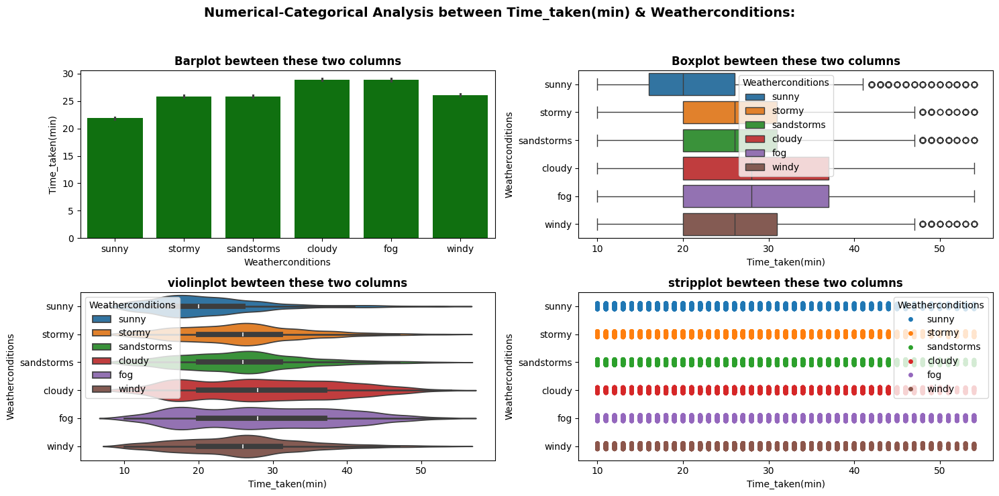

In [55]:
numerical_categorical_analysis(df, 'Time_taken(min)','Weatherconditions')

In [56]:
ANOVA(df, 'Time_taken(min)','Weatherconditions')

Null Hypothesis: There is no relationship between Time_taken(min) & Weatherconditions.
0.0
Reject the null hypothesis.
There is a strong relationship between Time_taken(min) & Weatherconditions.


__________________________________

#### **`Road_traffic_density`:**

In [58]:
categorical_analysis(df,'Road_traffic_density')

,Road_traffic_density,Count,Percentage
0,low,15477,34.4%
1,jam,14143,31.43%
2,medium,10947,24.33%
3,high,4425,9.84%


For Road_traffic_density, these are the unique values:
['high', 'jam', 'low', 'medium']
There are total 4 unique values.




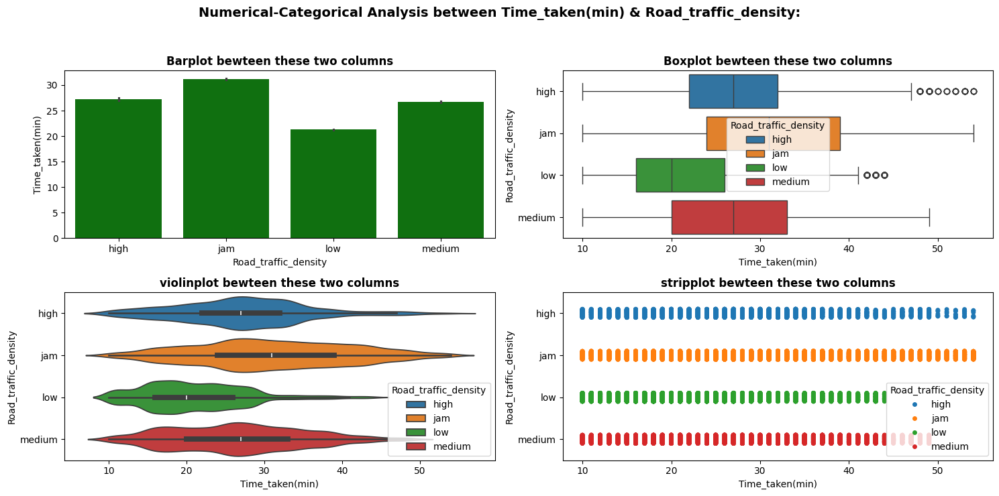

In [59]:
numerical_categorical_analysis(df,'Time_taken(min)','Road_traffic_density')

In [60]:
ANOVA(df,'Time_taken(min)','Road_traffic_density')

Null Hypothesis: There is no relationship between Time_taken(min) & Road_traffic_density.
0.0
Reject the null hypothesis.
There is a strong relationship between Time_taken(min) & Road_traffic_density.


____________________________________________

#### **`Type_of_order`:**

In [61]:
categorical_analysis(df,'Type_of_order')

,Type_of_order,Count,Percentage
0,snack,11512,25.3%
1,meal,11435,25.13%
2,drinks,11294,24.82%
3,buffet,11261,24.75%


For Type_of_order, these are the unique values:
['snack', 'drinks', 'buffet', 'meal']
There are total 4 unique values.




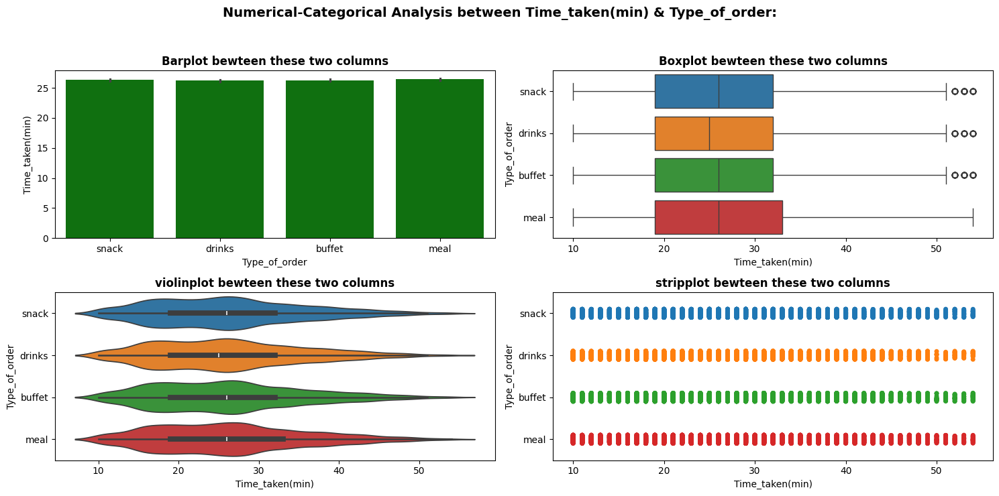

In [62]:
numerical_categorical_analysis(df,'Time_taken(min)','Type_of_order')

In [63]:
ANOVA(df,'Time_taken(min)','Type_of_order')

Null Hypothesis: There is no relationship between Time_taken(min) & Type_of_order.
0.3043309877239704
Fail to reject the null hypothesis.
There is a no relationship between Time_taken(min) & Type_of_order.


__________________________________

#### **`Type_of_vehicle`:**

In [64]:
categorical_analysis(df,'Type_of_vehicle')

,Type_of_vehicle,Count,Percentage
0,motorcycle,26427,58.08%
1,scooter,15244,33.5%
2,electric_scooter,3778,8.3%
3,bicycle,53,0.12%


For Type_of_vehicle, these are the unique values:
['motorcycle', 'scooter', 'electric_scooter', 'bicycle']
There are total 4 unique values.




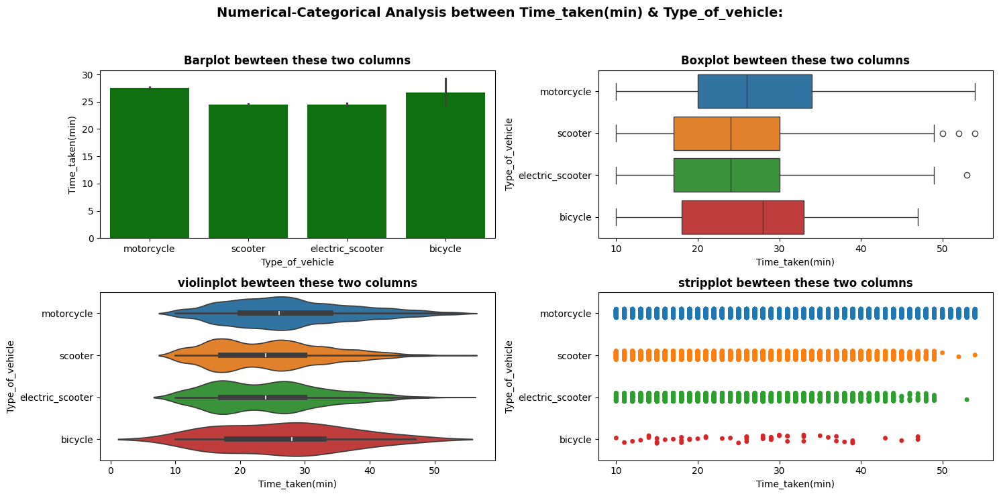

In [65]:
numerical_categorical_analysis(df,'Time_taken(min)','Type_of_vehicle')

In [66]:
ANOVA(df,'Time_taken(min)','Type_of_vehicle')

Null Hypothesis: There is no relationship between Time_taken(min) & Type_of_vehicle.
1.501402949551519e-269
Reject the null hypothesis.
There is a strong relationship between Time_taken(min) & Type_of_vehicle.


___________________________________

#### **`Festival`:**

In [67]:
categorical_analysis(df,'Festival')

,Festival,Count,Percentage
0,no,44380,98.03%
1,yes,894,1.97%


For Festival, these are the unique values:
['no', 'yes']
There are total 2 unique values.




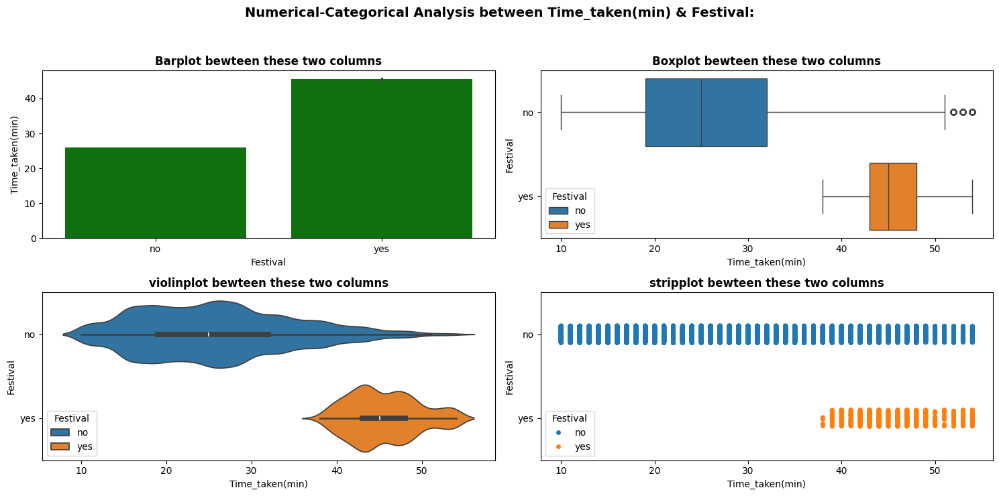

In [68]:
numerical_categorical_analysis(df,'Time_taken(min)','Festival')

In [69]:
ANOVA(df,'Time_taken(min)','Festival')

Null Hypothesis: There is no relationship between Time_taken(min) & Festival.
0.0
Reject the null hypothesis.
There is a strong relationship between Time_taken(min) & Festival.


__________________________

#### **`City`:**

In [71]:
categorical_analysis(df,'City')

,City,Count,Percentage
0,metropolitian,34029,76.81%
1,urban,10111,22.82%
2,semi-urban,164,0.37%


For City, these are the unique values:
['urban', 'metropolitian', 'semi-urban']
There are total 3 unique values.




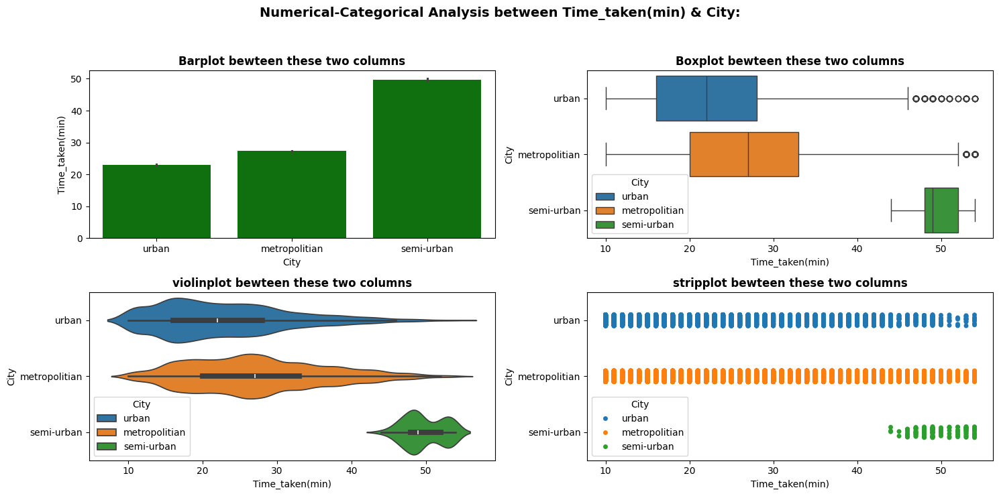

In [72]:
numerical_categorical_analysis(df,'Time_taken(min)','City')

In [73]:
ANOVA(df,'Time_taken(min)','City')

Null Hypothesis: There is no relationship between Time_taken(min) & City.
0.0
Reject the null hypothesis.
There is a strong relationship between Time_taken(min) & City.


_________________________________

#### **SUMMARY:**

- `rider_city`,`Type_of_order` these two columns has no relationship with our target column.

- `order_dayname`,`time_of_day`,`Weatherconditions`,`Road_traffic_density`,`Type_of_vehicle`,`Festival` ,`City` - these columns has a strong relationship with target column.


__________________________________________
_________________________________________

### **Numerical column Analysis:**

In [77]:
df[num_cols].describe().T

,count,mean,std,min,25%,50%,75%,max
Delivery_person_Age,43648.0,29.555008,5.761482,20.000000,25.000000,30.000000,35.000000,39.000000
Delivery_person_Ratings,43594.0,4.635287,0.313827,2.500000,4.500000,4.700000,4.900000,5.000000
Distance_res_loc_KM,41872.0,9.719310,5.602898,1.465069,4.657661,9.193027,13.680939,20.969518
order_in_weekend,45502.0,0.274867,0.446452,0.000000,0.000000,0.000000,1.000000,1.000000
order_time_hr,43862.0,17.423966,4.817856,0.000000,15.000000,19.000000,21.000000,23.000000
Time_res_pickup,43862.0,9.989399,4.087516,5.000000,5.000000,10.000000,15.000000,15.000000
Vehicle_condition,45502.0,1.019406,0.835229,0.000000,0.000000,1.000000,2.000000,3.000000
multiple_deliveries,44509.0,0.744928,0.572488,0.000000,0.000000,1.000000,1.000000,3.000000


____________________________

In [84]:
#sns.heatmap(df[num_cols].corr(),annot=True)
fig = px.imshow(round(df[num_cols].corr(),3),text_auto=True)
fig.update_layout(
    width=1000,
    height=600
)

# Increase text size
fig.update_traces(textfont_size=12)

fig.show()

#### **`Delivery_person_Age`:**

count    43648.000000
mean        29.555008
std          5.761482
min         20.000000
25%         25.000000
50%         30.000000
75%         35.000000
max         39.000000
Name: Delivery_person_Age, dtype: float64


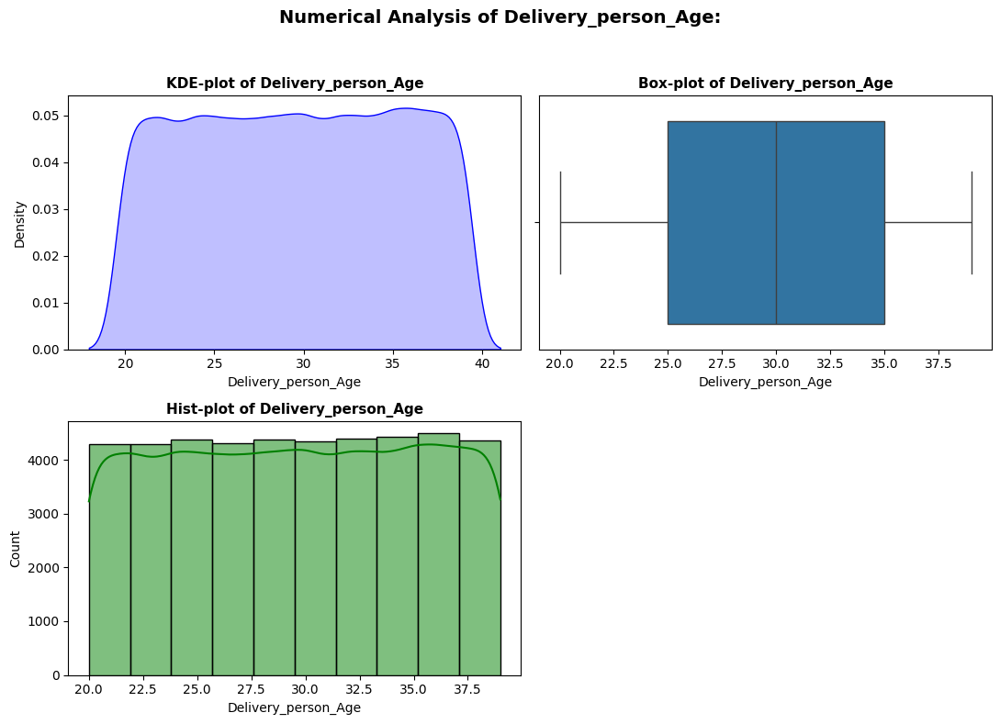

In [85]:
numerical_analysis(df, 'Delivery_person_Age',bin=10)

 if delivery person age effect the time_taken:

In [86]:
px.scatter(data_frame=df, x='Delivery_person_Age',y='Time_taken(min)')

In [87]:
px.imshow(df[['Time_taken(min)','Delivery_person_Age']].corr(),text_auto=True)

So, we can observe that there is a corelation between these two columns.

___________________________________________________

#### **`Delivery_person_Ratings`:**

count    43594.000000
mean         4.635287
std          0.313827
min          2.500000
25%          4.500000
50%          4.700000
75%          4.900000
max          5.000000
Name: Delivery_person_Ratings, dtype: float64


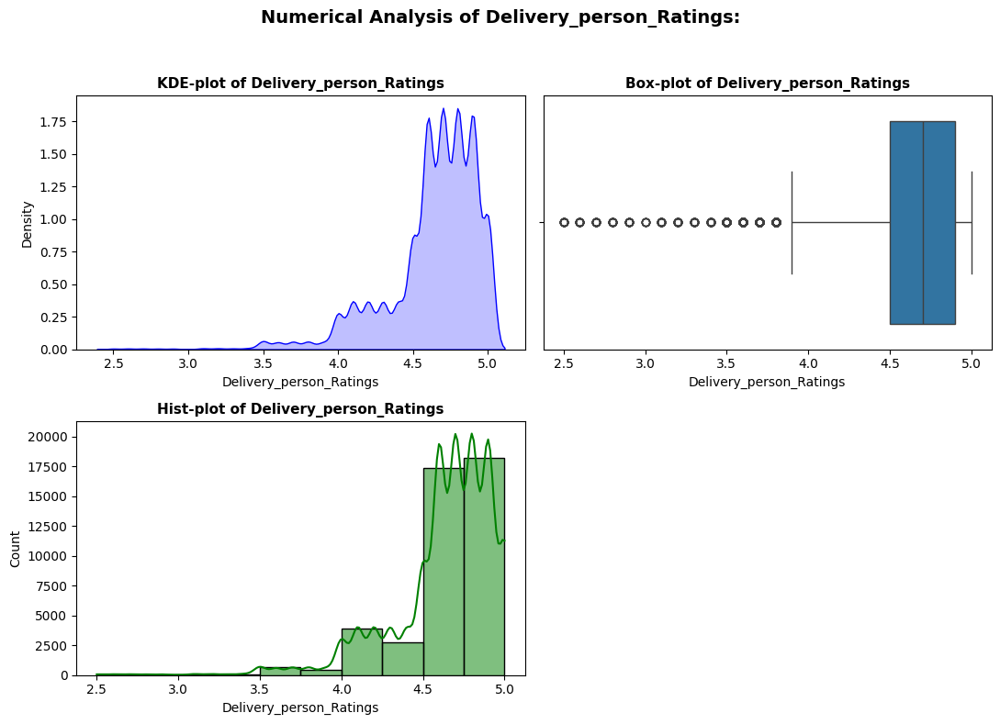

In [88]:
numerical_analysis(df, 'Delivery_person_Ratings',bin=10)

In [89]:
px.imshow(df[['Time_taken(min)','Delivery_person_Ratings']].corr(),text_auto=True)

In [90]:
fig = px.scatter(df,'Time_taken(min)','Delivery_person_Ratings')
fig.update_layout(title={"text":"scatterplot","x":0.5,"xanchor":"center"})

- we can also conclude for these two column that they have strong relationship.

___________________________________________________

#### **columns: `Distance_res_loc_KM`:**

count    41872.000000
mean         9.719310
std          5.602898
min          1.465069
25%          4.657661
50%          9.193027
75%         13.680939
max         20.969518
Name: Distance_res_loc_KM, dtype: float64


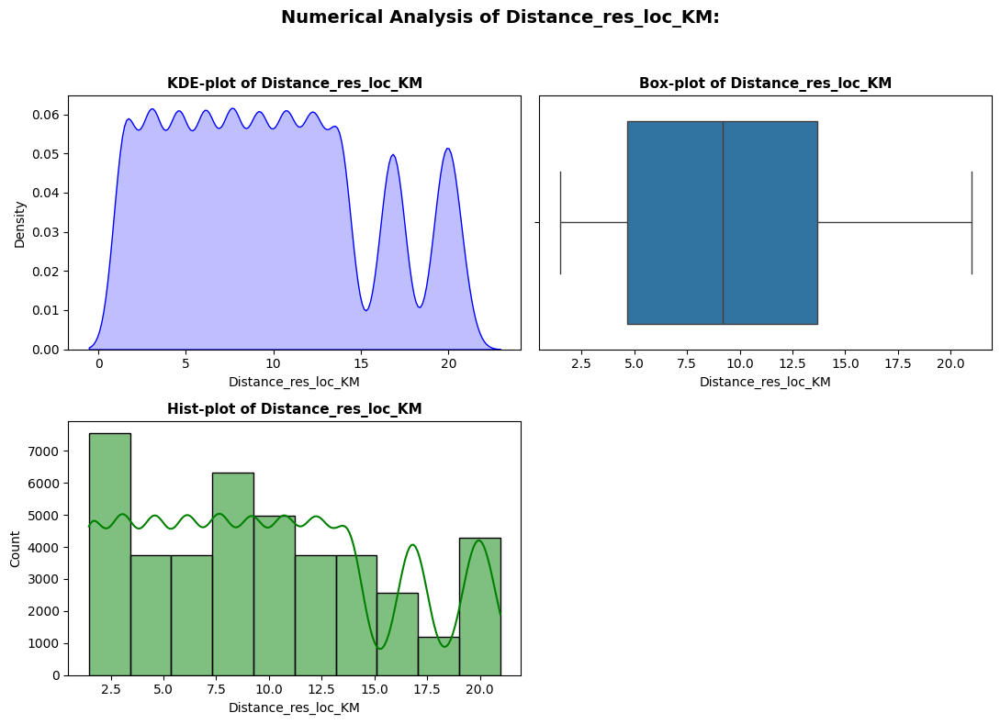

In [91]:
numerical_analysis(df,'Distance_res_loc_KM',bin=10)

In [92]:
px.imshow(df[['Time_taken(min)','Distance_res_loc_KM']].corr(),text_auto=True)

In [93]:
fig =  px.scatter(df,x='Time_taken(min)',y='Distance_res_loc_KM')
fig.update_layout(title={'text':'scatterplot for Distance_res_loc_KM:',"x":0.5,"xanchor":"center"})
fig.show()

______________________________________________________

#### **`order_in_weekend`:**

count    45502.000000
mean         0.274867
std          0.446452
min          0.000000
25%          0.000000
50%          0.000000
75%          1.000000
max          1.000000
Name: order_in_weekend, dtype: float64


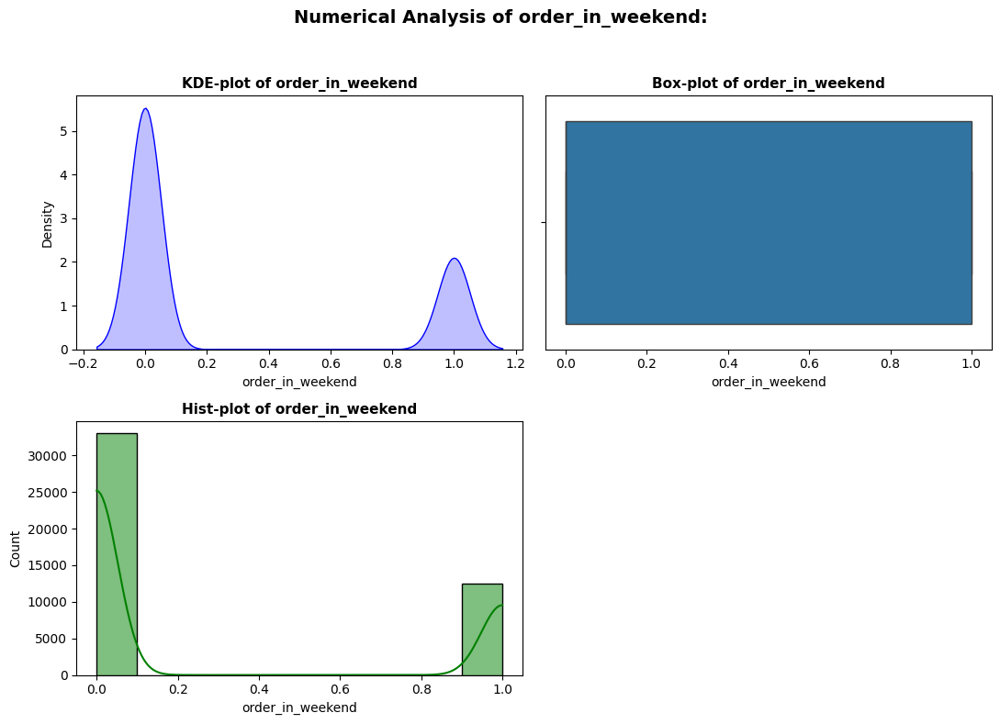

In [94]:
numerical_analysis(df,'order_in_weekend',bin=10)

In [98]:
px.scatter(df,'Time_taken(min)','order_in_weekend').update_layout(title = {'text':"scatterplot of weekend:",
                                                                           "x":0.5,"xanchor":"center"},font = {
                                                                               "family":"Arial"
                                                                           })


In [99]:
px.imshow(df[['Time_taken(min)','order_in_weekend']].corr(),text_auto=True)

- We can observe that there is no such relationship between these two columns.

In [105]:
temp_df = df[['Time_taken(min)','order_in_weekend']]
temp_df['order_in_weekend'] = temp_df['order_in_weekend'].astype('str')
temp_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 45502 entries, 0 to 45592
Data columns (total 2 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Time_taken(min)   45502 non-null  float64
 1   order_in_weekend  45502 non-null  object 
dtypes: float64(1), object(1)
memory usage: 2.0+ MB


In [107]:
px.box(temp_df,x='order_in_weekend',y='Time_taken(min)')

- No such strong relationship between these two columns.

________________________________________

#### **`order_time_hr`:**

count    43862.000000
mean        17.423966
std          4.817856
min          0.000000
25%         15.000000
50%         19.000000
75%         21.000000
max         23.000000
Name: order_time_hr, dtype: float64


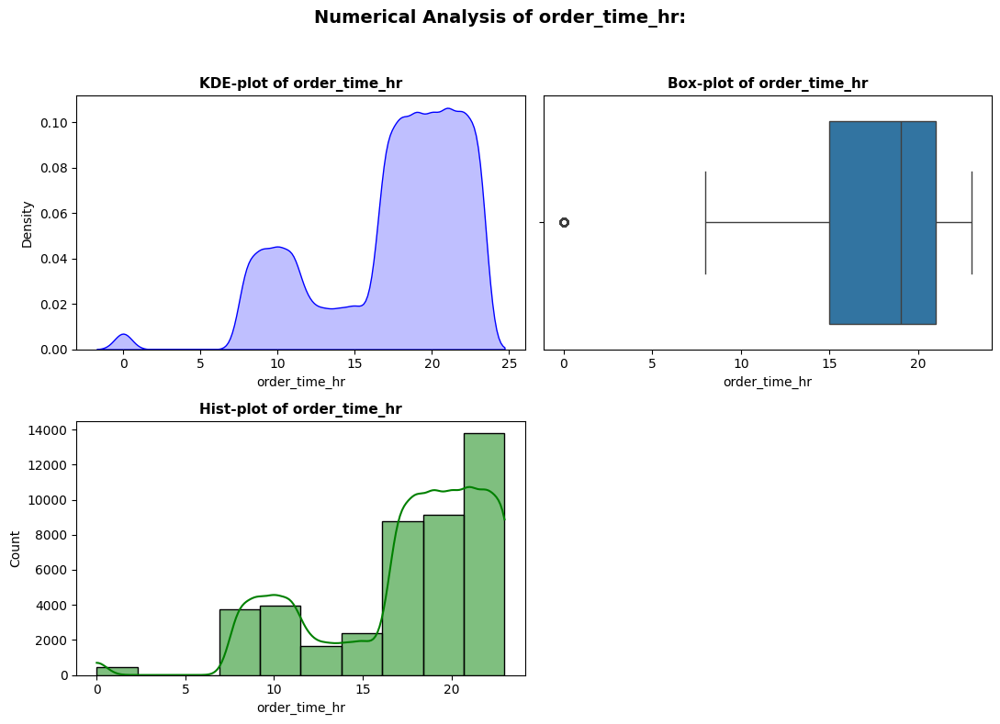

In [110]:
numerical_analysis(df,'order_time_hr',bin=10)

In [112]:
px.imshow(df[['Time_taken(min)','order_time_hr']].corr(),text_auto=True)

- Here it is shown that there is a strong relationship between these two columns. But there is a corelationship between `order_time_hr` & `Distance_res_loc_KM`.

______________________________________________

#### **`Time_res_pickup`:**

count    43862.000000
mean         9.989399
std          4.087516
min          5.000000
25%          5.000000
50%         10.000000
75%         15.000000
max         15.000000
Name: Time_res_pickup, dtype: float64


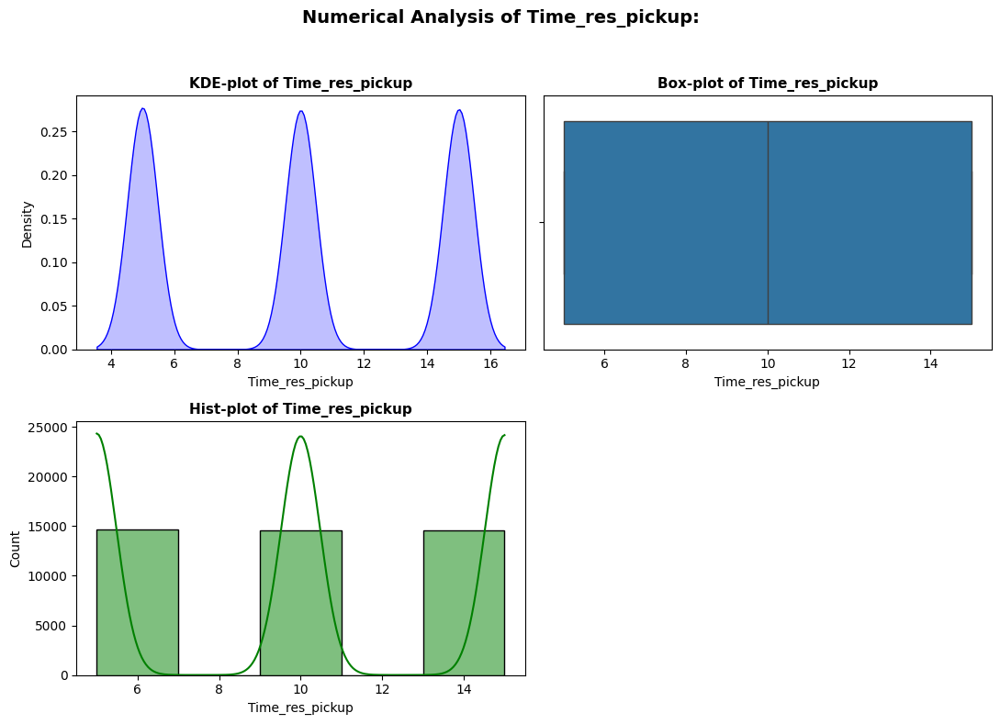

In [113]:
numerical_analysis(df,'Time_res_pickup',bin=5)

- It seems like it is a categorical column.

In [114]:
px.imshow(df[['Time_taken(min)','Time_res_pickup']].corr(),text_auto=True)

- There is no such strong relationship between these two columns.

______________________________________

#### **`Vehicle_condition`:**

- It an encoded categorical column.

In [115]:
temp_df = df[['Time_taken(min)','Vehicle_condition']]
temp_df['Vehicle_condition'] = temp_df['Vehicle_condition'].astype('str')

In [116]:
categorical_analysis(temp_df,'Vehicle_condition')

,Vehicle_condition,Count,Percentage
0,2,15034,33.04%
1,1,15030,33.03%
2,0,15009,32.99%
3,3,429,0.94%


For Vehicle_condition, these are the unique values:
['2', '0', '1', '3']
There are total 4 unique values.




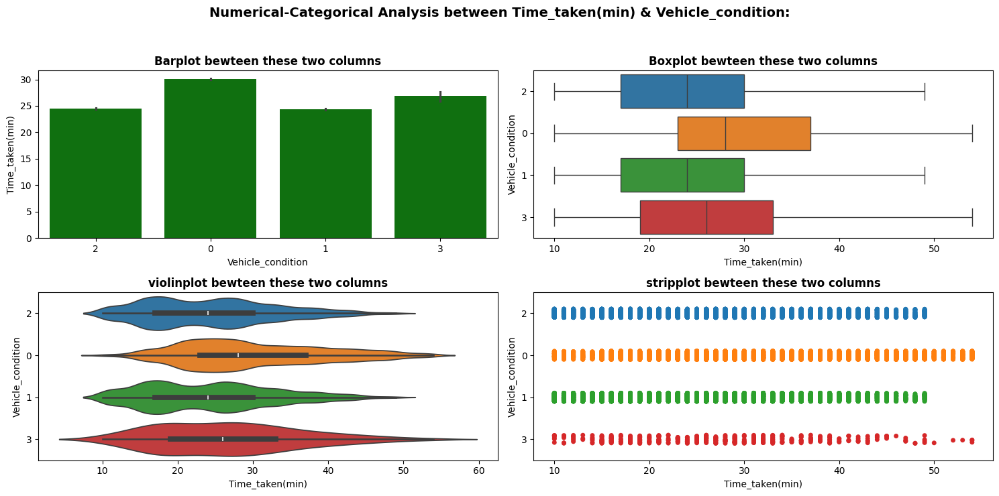

In [117]:
numerical_categorical_analysis(temp_df,'Time_taken(min)','Vehicle_condition')

In [119]:
ANOVA(temp_df,'Time_taken(min)','Vehicle_condition')

Null Hypothesis: There is no relationship between Time_taken(min) & Vehicle_condition.
0.0
Reject the null hypothesis.
There is a strong relationship between Time_taken(min) & Vehicle_condition.


In [120]:
px.imshow(df[['Time_taken(min)','Vehicle_condition']].corr(),text_auto=True)

- We can observe that there is a strong relationship between these two columns.

________________________________

#### **`multiple_deliveries`:**

In [122]:
df['multiple_deliveries'].unique()

array([ 0.,  1.,  3., nan,  2.])

- It also seems like categorical columns.

In [125]:
temp_df = df[['Time_taken(min)','multiple_deliveries']].dropna()
temp_df['multiple_deliveries'] = temp_df['multiple_deliveries'].astype('str')

In [126]:
categorical_analysis(temp_df, 'multiple_deliveries')

,multiple_deliveries,Count,Percentage
0,1.0,28109,63.15%
1,0.0,14057,31.58%
2,2.0,1982,4.45%
3,3.0,361,0.81%


For multiple_deliveries, these are the unique values:
['0.0', '1.0', '3.0', '2.0']
There are total 4 unique values.




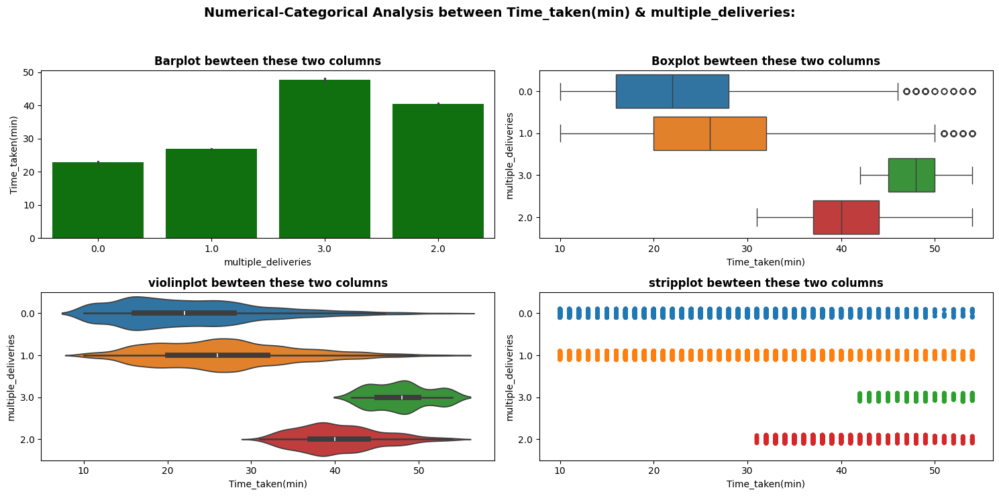

In [127]:
numerical_categorical_analysis(temp_df,'Time_taken(min)','multiple_deliveries')

In [128]:
ANOVA(temp_df,'Time_taken(min)','multiple_deliveries')

Null Hypothesis: There is no relationship between Time_taken(min) & multiple_deliveries.
0.0
Reject the null hypothesis.
There is a strong relationship between Time_taken(min) & multiple_deliveries.


In [129]:
px.imshow(df[['Time_taken(min)','multiple_deliveries']].corr(),text_auto=True)

- So we can conclude that there is a strong relationship between these two columns.

_____________________________________

### **SUMMARY:**

- `order_in_weekend`,`Time_res_pickup` - these two column has no relationship with output column.

___________________________________________
________________________________________

### **Date column Analysis:**

In [130]:
df[time_cols]

,Order_Date,Time_Orderd,Time_Order_picked
0,2022-03-19,11:30:00,11:45:00
1,2022-03-25,19:45:00,19:50:00
2,2022-03-19,08:30:00,08:45:00
3,2022-04-05,18:00:00,18:10:00
4,2022-03-26,13:30:00,13:45:00
...,...,...,...
45588,2022-03-24,11:35:00,11:45:00
45589,2022-02-16,19:55:00,20:10:00
45590,2022-03-11,23:50:00,00:05:00
45591,2022-03-07,13:35:00,13:40:00


- No need to analysis

__________________________________________________
____________________________________________________

### **Location Column Analysis:**

In [131]:
df[loc_cols]

,Restaurant_latitude,Restaurant_longitude,Delivery_location_latitude,Delivery_location_longitude
0,22.745049,75.892471,22.765049,75.912471
1,12.913041,77.683237,13.043041,77.813237
2,12.914264,77.678400,12.924264,77.688400
3,11.003669,76.976494,11.053669,77.026494
4,12.972793,80.249982,13.012793,80.289982
...,...,...,...,...
45588,26.902328,75.794257,26.912328,75.804257
45589,NaN,NaN,NaN,NaN
45590,13.022394,80.242439,13.052394,80.272439
45591,11.001753,76.986241,11.041753,77.026241


In [132]:
fig = px.scatter_mapbox(df,lat='Restaurant_latitude',lon='Restaurant_longitude',hover_name='rider_city')

fig.update_layout(mapbox_style="carto-positron",
                  mapbox_center = {"lat":20.5937,'lon':78.9629},
                  mapbox_zoom = 3)
fig.show()


__________________________________________
______________________________________

**Now let's see if there is a connection with target column & all those non-related column together:**

In [133]:
non_rel = [
    "rider_city", "Type_of_order","order_in_weekend", "Time_res_pickup"
]

In [134]:
df[non_rel]

,rider_city,Type_of_order,order_in_weekend,Time_res_pickup
0,Indore,snack,1,15.0
1,Bengaluru,snack,0,5.0
2,Bengaluru,drinks,1,15.0
3,Coimbatore,buffet,0,10.0
4,Chennai,snack,1,15.0
...,...,...,...,...
45588,Jamshedpur,meal,0,10.0
45589,Agra,buffet,0,15.0
45590,Chennai,drinks,0,15.0
45591,Coimbatore,snack,0,5.0


In [135]:
px.box(df,'Type_of_order',y='Time_taken(min)',color='order_in_weekend')

In [136]:
px.box(df,'rider_city',y='Time_taken(min)',color='order_in_weekend')

In [137]:
temp_df = df[['Time_taken(min)','Time_res_pickup']].dropna()
temp_df['Time_res_pickup'] = temp_df['Time_res_pickup'].astype('str')

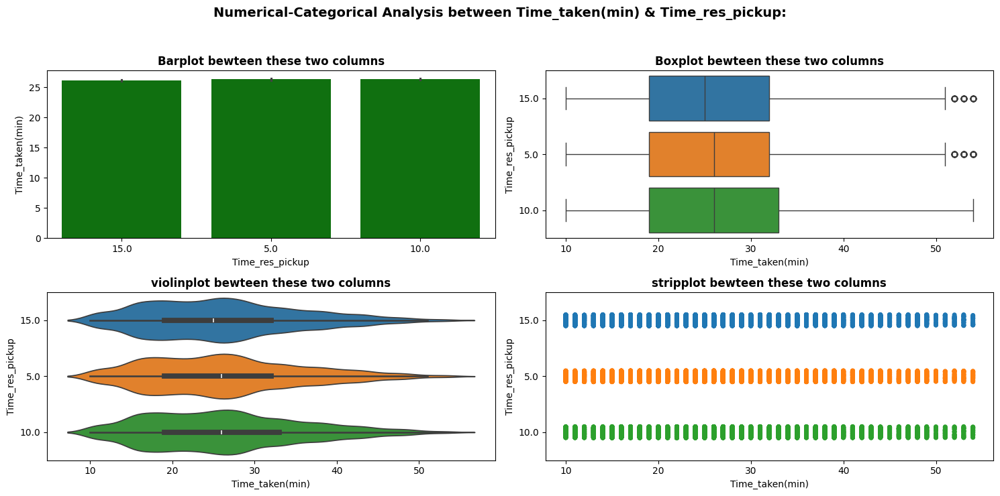

In [139]:
numerical_categorical_analysis(temp_df,'Time_taken(min)','Time_res_pickup')

In [164]:
ANOVA(temp_df,'Time_taken(min)','Time_res_pickup')

Null Hypothesis: There is no relationship between Time_taken(min) & Time_res_pickup.
0.09932647028954891
Fail to reject the null hypothesis.
There is a no relationship between Time_taken(min) & Time_res_pickup.


________________________________________________________
__________________________________________________________

### **Conclusion:**

- we can drop these following columns--

    - `rider_city`, `Type_of_order`

    - `order_in_weekend`, `Time_res_pickup`
    
    - `order_time_hr`

_______________________________________

#### **Final cleaning function will be**

In [154]:
def time_diff(row):

    order_picked = pd.to_timedelta(row['Time_Order_picked'])
    time_order =  pd.to_timedelta(row['Time_Orderd'])

    x = order_picked - time_order
    return x

def haversine_row(row):
    loc1 = (row['Restaurant_latitude'], row['Restaurant_longitude'])
    loc2 = (row['Delivery_location_latitude'], row['Delivery_location_longitude'])
    return hs.haversine(loc1, loc2, unit=hs.Unit.KILOMETERS)


def basic_data_cleaning(df):

    df.drop(columns=['ID'],inplace=True)
    df['Restaurant_latitude'] = abs(df['Restaurant_latitude'].replace(0,np.nan))
    df['Restaurant_longitude'] = abs(df['Restaurant_longitude'].replace(0,np.nan))
    cols = ["Delivery_location_latitude","Delivery_location_longitude"]
    df.loc[df['Restaurant_latitude'].isnull(), cols] = np.nan

    columns = ["Delivery_person_Age",  "Delivery_person_Ratings","Time_Orderd", "Weatherconditions", "Road_traffic_density",
    "multiple_deliveries", "Festival", "City"]
    for i in columns:
        df[i] = df[i].replace('NaN ',np.nan)
    df['Weatherconditions'] = df['Weatherconditions'].replace("conditions NaN",np.nan)
    df['Weatherconditions'] = df['Weatherconditions'].apply(lambda x: x.split()[-1] if isinstance(x, str) else x)
    df['Time_taken(min)'] = df['Time_taken(min)'].apply(lambda x: x[-2:]).astype("float")

    # changing datatype 
    df['Delivery_person_Age'] = df['Delivery_person_Age'].astype("float")
    df['Delivery_person_Ratings'] = df['Delivery_person_Ratings'].astype("float")
    df['Order_Date'] = pd.to_datetime(df['Order_Date'])
    df['multiple_deliveries'] = df['multiple_deliveries'].astype("float")

    # applying harversine distance
    df['Distance_res_to_loc_KM'] = df[['Restaurant_latitude', 'Restaurant_longitude','Delivery_location_latitude', 'Delivery_location_longitude']].apply(haversine_row,axis=1)
    df.insert(7,"Distance_res_loc_KM",df.pop('Distance_res_to_loc_KM'))

    # finding the time taken between restrurant & order pickup
    df["Time_res_pickup"] = (df[['Time_Order_picked','Time_Orderd']].apply(time_diff,axis=1).dt.total_seconds()/60).replace({-1425.:15., -1430.:10., -1435.:5.})
    df.insert(11,"Time_res_pickup",df.pop("Time_res_pickup"))
    df["order_time_hr"] = pd.to_datetime(df['Time_Orderd']).dt.hour
    df.insert(10,"order_time_hr",df.pop("order_time_hr"))
    df["time_of_day"] = pd.cut(
    df['order_time_hr'],
    bins=[0, 6, 12, 17, 20, 24],
    labels=['after midnight', 'morning', 'afternoon', 'evening', 'night'],
    right=False
    )
    df.insert(11,"time_of_day",df.pop("time_of_day"))

    # fixing values in columns:
    df['Road_traffic_density'] = df['Road_traffic_density'].str.strip().str.lower()
    df['Weatherconditions'] = df['Weatherconditions'].str.strip().str.lower()
    df['Type_of_order'] = df['Type_of_order'].str.strip().str.lower()
    df['Type_of_vehicle'] = df['Type_of_vehicle'].str.strip().str.lower()
    df['Festival'] = df['Festival'].str.strip().str.lower()
    df['City'] = df['City'].str.strip().str.lower()

    # dropping some rows
    df.drop(index=df[df['Delivery_person_Age'] <18].index,inplace=True)
    df.drop(index=df[df['Delivery_person_Ratings']>5].index,inplace=True)
    
    # creating rider city info
    rename_city = {"INDO":"Indore","BANG":"Bengaluru","COIMB":"Coimbatore","CHEN":"Chennai","HYD":"Hyderabad",
               "RANCHI":"Ranchi","MYS":"Mysore","DEH":"Dehradun","KOC":"Kochi","PUNE":"Pune","LUD":"Ludhiana",
               "LUDH":"Ludhiana","KNP":"Kanpur","MUM":"Mumbai","KOL":"Kolkata","JAP":"Jamshedpur","SUR":"Surat",
               "GOA":"Goa","AURG":"Aurangabad","AGR":"Agra","VAD":"Vadodara","ALH":"Allahabad","BHP":"Bhopal"}
    
    df['rider_city'] = df['Delivery_person_ID'].str.split("RES").str.get(0).replace(rename_city)
    df.insert(1,'rider_city',df.pop('rider_city'))
    df.insert(11,'order_dayname',df['Order_Date'].dt.day_name())
    df.insert(12,'order_in_weekend',np.where(df['order_dayname'].isin(['Saturday','Sunday']),1,0))
    

    df.drop(columns=['Delivery_person_ID'],inplace=True)

    # after doing EDA these columns are selected to be removed
    df.drop(columns=['rider_city','Type_of_order','order_in_weekend','order_time_hr','Time_res_pickup','Restaurant_latitude','Restaurant_longitude','Delivery_location_latitude','Delivery_location_longitude','Order_Date','Time_Orderd','Time_Order_picked'],inplace=True)
    
    return df

In [ ]:
df = pd.read_csv(r"E:\DATA SCIENCE & AI\PROJECTS\Swiggy Delivery Dataset\train.csv")

In [158]:
df.columns


Index(['ID', 'Delivery_person_ID', 'Delivery_person_Age',
       'Delivery_person_Ratings', 'Restaurant_latitude',
       'Restaurant_longitude', 'Delivery_location_latitude',
       'Delivery_location_longitude', 'Order_Date', 'Time_Orderd',
       'Time_Order_picked', 'Weatherconditions', 'Road_traffic_density',
       'Vehicle_condition', 'Type_of_order', 'Type_of_vehicle',
       'multiple_deliveries', 'Festival', 'City', 'Time_taken(min)'],
      dtype='object')

In [159]:
len(df.columns)

20

In [160]:
df = basic_data_cleaning(df)

In [161]:
df.columns

Index(['Delivery_person_Age', 'Delivery_person_Ratings', 'Distance_res_loc_KM',
       'order_dayname', 'time_of_day', 'Weatherconditions',
       'Road_traffic_density', 'Vehicle_condition', 'Type_of_vehicle',
       'multiple_deliveries', 'Festival', 'City', 'Time_taken(min)'],
      dtype='object')

In [162]:
len(df.columns)

13

_____________________________________________________________
________________________________
_________________________